# Cleaning data for the segmentation model
This file is used:
<ul>
<li> Select 100 scenes to be labelled 
<li> Create RGB images using entire landsat scenes. These are then labelled and the final product is considered a rough label. 
<li> Clean labels from the above process
<li> Crop 100 test images
<li> Crop 30000 training images that are geographical independent of the test images 
</ul>

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image 
import rasterio as rio

import os
import cv2

# Reload utils
import importlib
import utils
importlib.reload(utils)

base_path = '../data/'

# Create stack tiff files

In [ ]:
df_label = pd.read_csv('../data/label_scenes.csv')

# save label as tif file
for id in df_label['id']:
    # load label
    mask = np.load(base_path + 'clean labels/' + id + '.npy')

    tiff_file = base_path + "raw scenes/{}/{}_mask.TIF".format(id,id)
    tiff.imsave(tiff_file, mask)


In [ ]:
for ID in df_label['id']:

    if ID[0:4] in ['LT05','LE07']:
        bands = ['SR_B1','SR_B2','SR_B3','SR_B4','SR_B5','SR_B7','ST_B6','mask']
    else:
        bands = ['SR_B2','SR_B3','SR_B4','SR_B5','SR_B6','SR_B7','ST_B10','mask']


    paths = [base_path+'raw scenes/{}/{}_{}.TIF'.format(ID,ID,band) for band in bands]

    # load all bands and label with rasterio
    with rio.open(paths[0]) as src:
        meta = src.meta
        meta.update(count=len(paths))

    save_path = base_path + 'stacked/{}.TIF'.format(ID)
    with rio.open(save_path, 'w', **meta) as dst:
        for id, layer in enumerate(paths, start=1):
            with rio.open(layer) as src1:
                dst.write_band(id, src1.read(1))

# Create RGB visualization of each landsat scene

In [4]:
df_label = pd.read_csv('../data/label_scenes.csv')

print(df_label[['path','row']].value_counts(sort=False))
df_label[['path','row']].value_counts(sort=False).to_clipboard()

print(df_label['altitude_category'].value_counts())

path  row
205   23     11
      24     20
206   22      9
      23      6
      24     10
207   22      9
      23     10
      24      7
208   22      6
      23      6
      24      6
dtype: int64
low       34
medium    34
high      32
Name: altitude_category, dtype: int64


In [56]:
# create RGB images 
for i, row in df_label.iterrows():
    try:
        id = row['id']
        RGB = utils.get_igb(id)
        RGB = utils.trim_RGB(RGB)
        RGB_ = (RGB*255).astype(np.uint8)
        im = Image.fromarray(RGB_)
        im.save(base_path+"RGB/{}.png".format(id))
    except:
        print(id)

TRIM
TRIM
TRIM
TRIM
TRIM


11


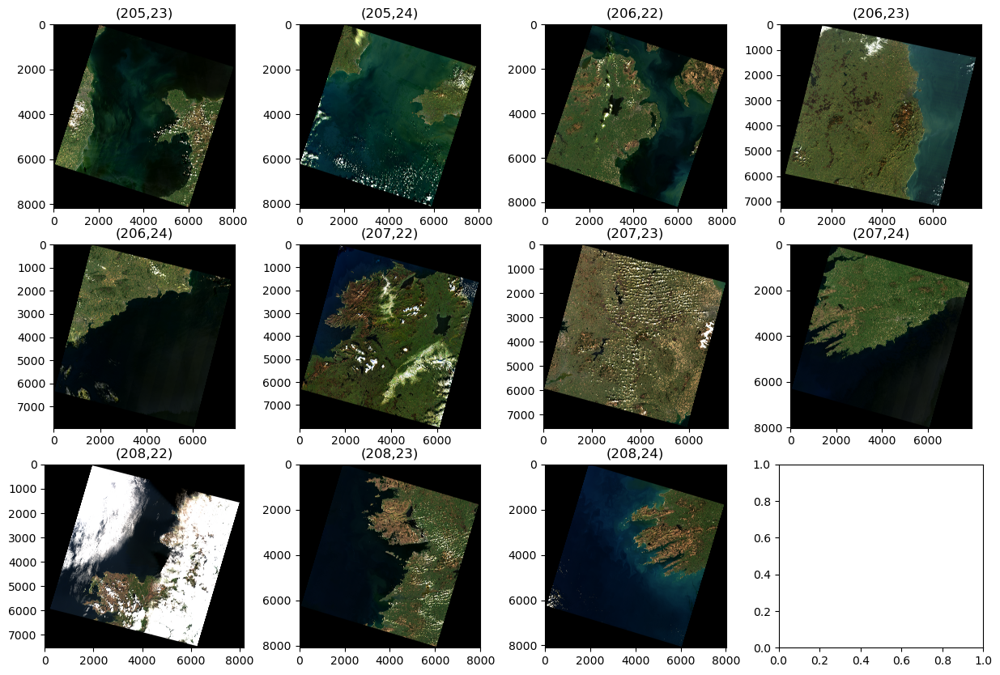

In [7]:
# display examples of each path and row 
df = df_label.groupby(['path', 'row']).first().reset_index()
print(len(df))
df.head()

fig, ax = plt.subplots(3, 4, figsize=(15, 10))

for i, row in df.iterrows():
    rgb = utils.get_rgb(row['id'])
    ax[i//4, i%4].imshow(rgb)
    ax[i//4, i%4].set_title("({},{})".format(row['path'], row['row']))
    #ax[i//4, i%4].axis('off')

#ax[2, 3].axis('off')

# Clean labels

In [2]:
df_label = pd.read_csv('../data/label_scenes.csv')

# Get list of RGB visualizations that were trimmed
trimmed = []
for id in df_label['id']:
    try:
        rgb = utils.get_igb(id)

        x,y,z = rgb.shape

        if x*y > 67000000:
            trimmed.append(id)
    except:
        print(id)

In [3]:
label_names = os.listdir(base_path + 'rough labels/')

#Only keep .npy files
label_names = [name for name in label_names if name[-4:]=='.npy']

#sort labels
label_names = sorted(label_names)

print(len(label_names))

104


In [4]:
# create initial label masks
masks = []
prev_task = None
for label in label_names:

    # get task number
    task = label.split('-')[1]

    # load label
    mask = np.load(base_path + 'rough labels/' + label)
    mask = np.clip(mask,0,1)

    if task != prev_task:
        masks.append(mask)
    else:
        # add to previous mask if same task
        masks[-1] = masks[-1] + mask
        masks[-1] = np.clip(masks[-1],0,1)


    prev_task = task
print(len(masks))

100


In [5]:
# untrim labels
for i, mask in enumerate(masks):

    id = df_label.iloc[i]['id']

    if id in trimmed:
        masks[i] = utils.untrim_label(mask)
        print(i,id)


11 LC08_L2SP_206022_20140418_20200911_02_T1
12 LC08_L2SP_206022_20140723_20200911_02_T1
13 LC08_L2SP_206022_20170325_20200904_02_T1
14 LC08_L2SP_206022_20180702_20200831_02_T1
15 LC08_L2SP_206022_20230310_20230320_02_T1


In [10]:
#clean masks
for i, mask in enumerate(masks):

    # make mask = 1 for water and 0 otherwise
    masks[i] = 1 - np.array(mask)

    try: 
        id = df_label.iloc[i]['id']
        RGB = utils.get_igb(id)

        # make mask = 0 where RGB = 0
        flag = RGB[:,:,]==[0,0,0]
        flag = np.sum(flag,axis=2)
        flag = flag==3
        
        masks[i][flag] = 0
    except:
        print(id)

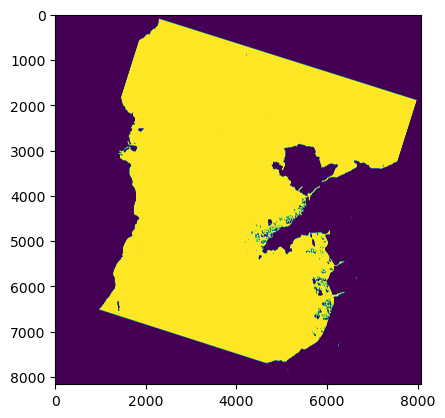

In [11]:
plt.imshow(masks[0])

In [ ]:
# use cloud mask to remove clouds


In [12]:
# save masks as .npy files
for i, mask in enumerate(masks):
    id = df_label.iloc[i]['id']
    np.save(base_path + 'clean labels/' + id + '.npy', mask)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
/var/folders/_j/wkrsnnnn2lj6cds3dhhlkkh40000gn/T/ipykernel_77239/637180680.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax = plt.subplots(1,2,figsize=(10,20))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with

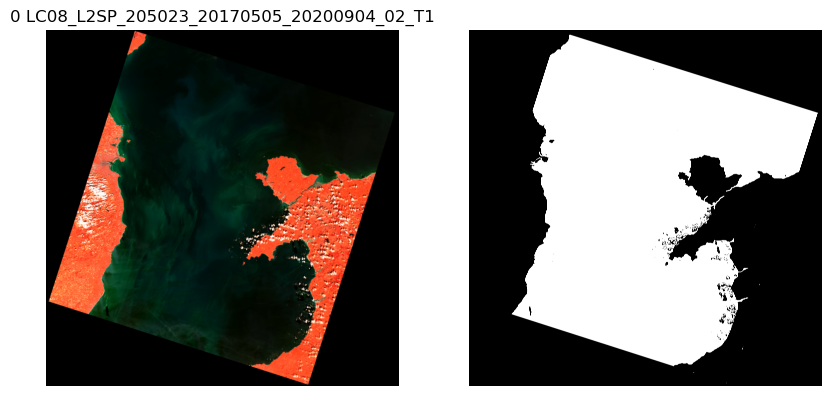

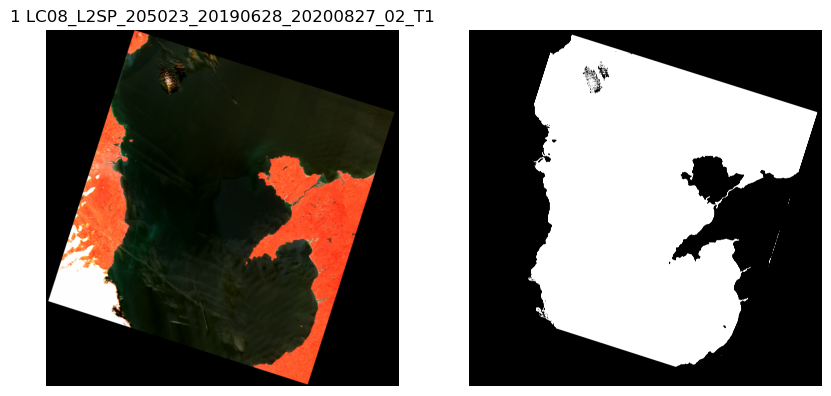

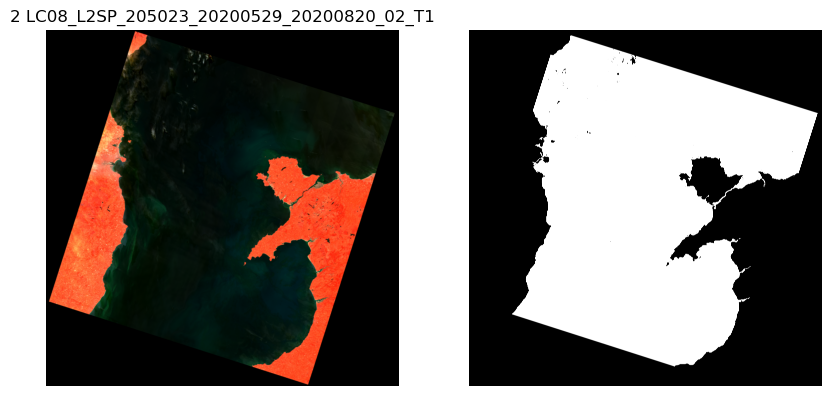

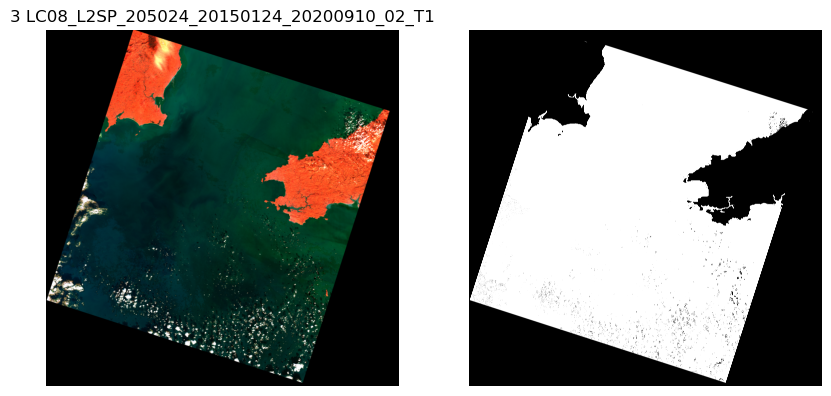

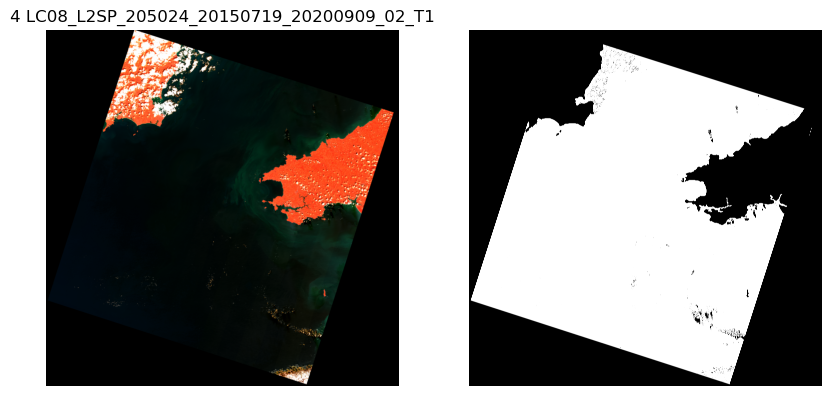

...

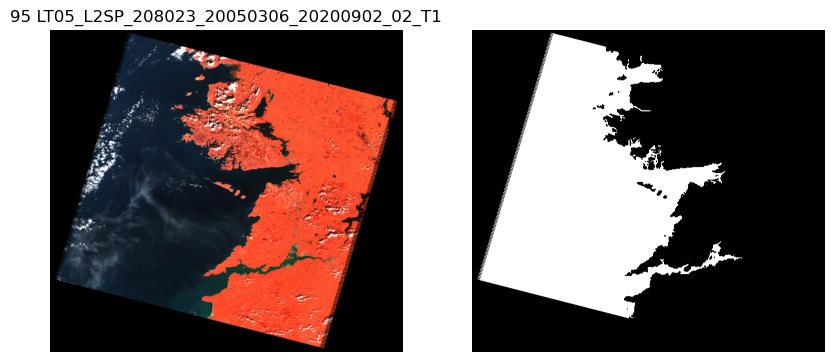

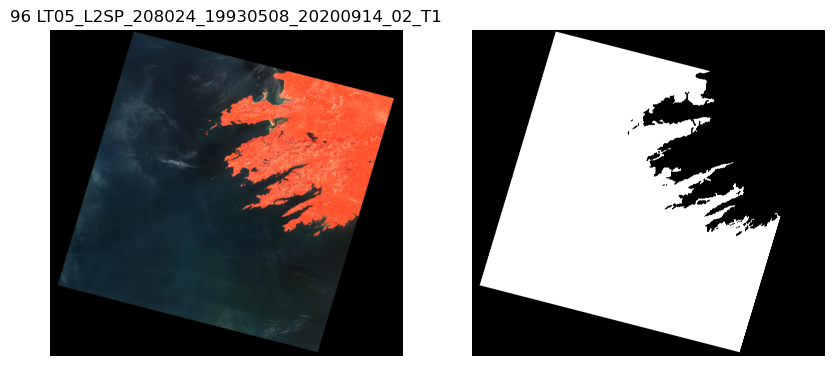

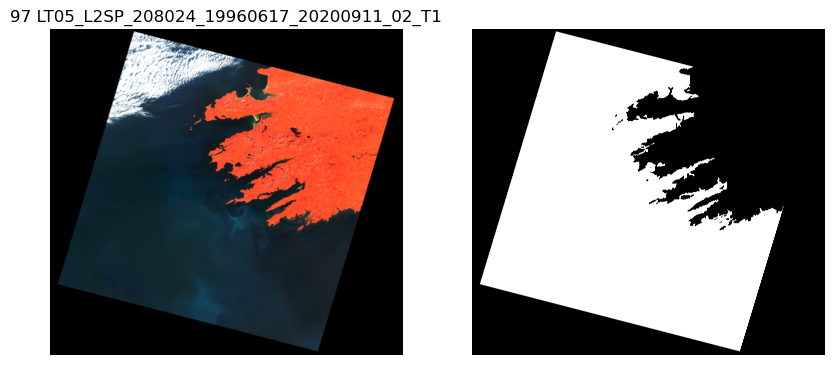

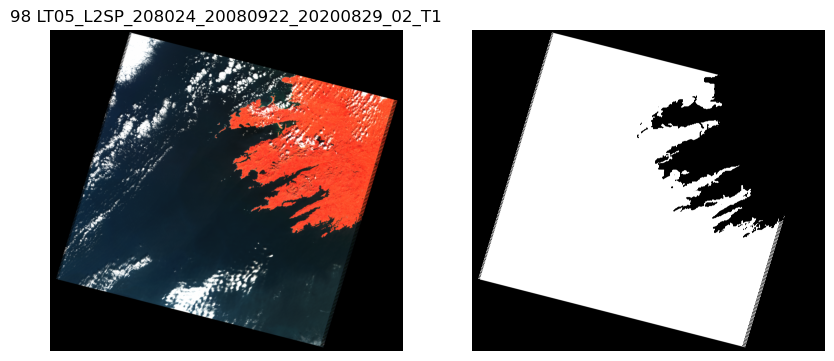

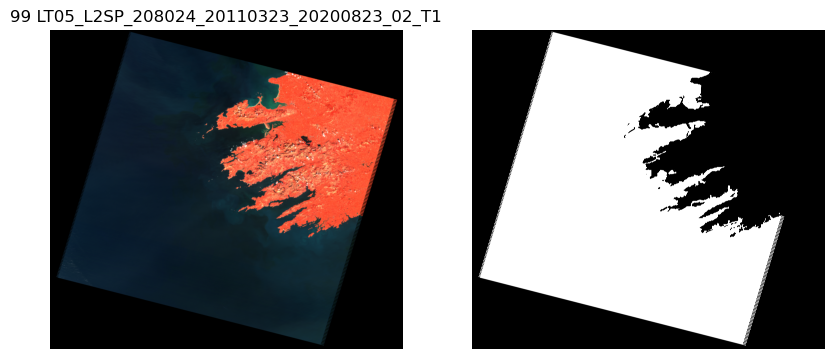

In [14]:
# display all rgb images and masks 
for i, mask in enumerate(masks):


    id = df_label.iloc[i]['id']
    RGB = utils.get_igb(id)

    # check if mask is binary
    if set(mask.ravel()) != {0,1}:
        print(i,id,"NOT BINARY")

    # reduce RGB dimensions
    RGB = cv2.resize(RGB, (int(mask.shape[1]/10), int(mask.shape[0]/10)), interpolation = cv2.INTER_AREA)

    # display RGB and mask
    fig,ax = plt.subplots(1,2,figsize=(10,20))

    ax[0].imshow(RGB)
    ax[0].title.set_text("{} {}".format(i,id))

    ax[1].imshow(mask,cmap='gray')

    ax[0].axis('off')
    ax[1].axis('off')

# Create stack tiff files


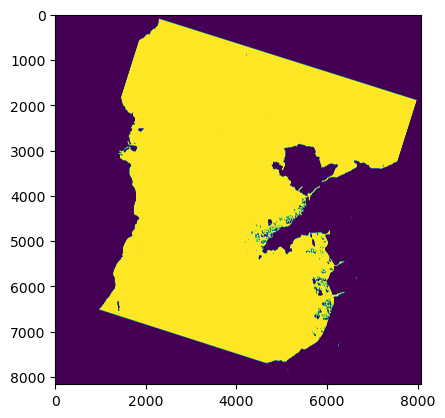

In [141]:
ID = df_label['id'][0]
mask = tiff.imread(base_path + "raw scenes/{}/{}_mask.TIF".format(ID,ID))
plt.imshow(mask)

/Users/conorosullivan/opt/miniconda3/envs/pytorch/lib/python3.10/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


# Crop test images

In [129]:
bands = utils.get_bands("LC08_L2SP_206022_20140418_20200911_02_T1")



In [ ]:
ID = df_label.iloc[0]['id']

def get_bands(ID):
    #Load all bands for a given landsat image

    if ID[0:4] in ['LT05','LE07']:
        # Landsat 5 and 7
        B1 = tiff.imread(base_path+'{}/{}_SR_B1.TIF'.format(ID, ID)) # Blue
        B2 = tiff.imread(base_path+'{}/{}_SR_B2.TIF'.format(ID, ID)) # Green
        B3 = tiff.imread(base_path+'{}/{}_SR_B3.TIF'.format(ID, ID)) # Red
        B4 = tiff.imread(base_path+'{}/{}_SR_B4.TIF'.format(ID, ID)) # NIR
        B5 = tiff.imread(base_path+'{}/{}_SR_B5.TIF'.format(ID, ID)) # SWIR1
        B7 = tiff.imread(base_path+'{}/{}_SR_B7.TIF'.format(ID, ID)) # SWIR2
        B6 = tiff.imread(base_path+'{}/{}_ST_B6.TIF'.format(ID, ID)) # Thermal

        bands = np.dstack((B1, B2, B3, B4, B5, B7, B6))

    else:
        # Landsat 8 and 9
        B2 = tiff.imread(base_path+'{}/{}_SR_B2.TIF'.format(ID, ID)) # Blue
        B3 = tiff.imread(base_path+'{}/{}_SR_B3.TIF'.format(ID, ID)) # Green
        B4 = tiff.imread(base_path+'{}/{}_SR_B4.TIF'.format(ID, ID)) # Red
        B5 = tiff.imread(base_path+'{}/{}_SR_B5.TIF'.format(ID, ID)) # NIR
        B6 = tiff.imread(base_path+'{}/{}_SR_B6.TIF'.format(ID, ID)) # SWIR1
        B7 = tiff.imread(base_path+'{}/{}_SR_B7.TIF'.format(ID, ID)) # SWIR2
        B10 = tiff.imread(base_path+'{}/{}_ST_B10.TIF'.format(ID, ID)) # Thermal 1

        bands = np.dstack((B2, B3, B4, B5, B6, B7, B10))

    return bands


/Users/conorosullivan/opt/miniconda3/envs/pytorch/lib/python3.10/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


In [146]:
# load stack
stack = tiff.imread(save_path)

stack.shape

(8161, 8081, 8)

In [157]:
stack = rio.open(save_path)

np_stack = [np.array(stack.read(i)) for i in range(1,9)]
np_stack = np.array(np_stack).transpose(1,2,0)

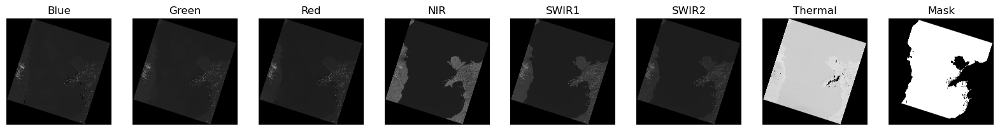

In [160]:
utils.display_bands(np_stack,True)

In [ ]:
# Read metadata of first file
with rio.open(file_list[0]) as src0:
    meta = src0.meta

In [ ]:




# Update meta to reflect the number of layers
meta.update(count = len(file_list))

# Read each layer and write it to stack
with rio.open('stack.tif', 'w', **meta) as dst:
    for id, layer in enumerate(file_list, start=1):
        with rio.open(layer) as src1:
            dst.write_band(id, src1.read(1))

# Crop Training images and labels 

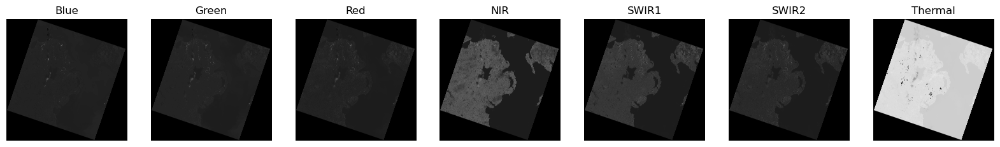

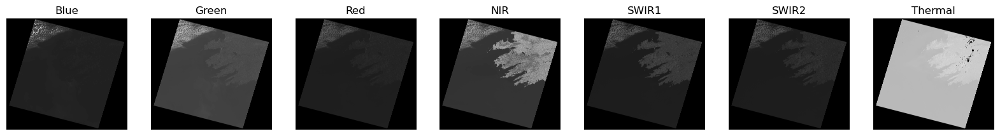

In [67]:
bands = utils.get_bands("LC08_L2SP_206022_20140418_20200911_02_T1")
utils.display_bands(bands)

bands = utils.get_bands("LT05_L2SP_208024_19960617_20200911_02_T1")
utils.display_bands(bands)

In [67]:
#crop a random 256x256 image from each scene

def random_crop(bands, size=256,return_loc=False):

    """Get crop with random location and rotation"""

    # get image dimensions
    x,y,z = bands.shape

    # get random location
    x0 = np.random.randint(0,x-size)
    y0 = np.random.randint(0,y-size)

    # crop image
    crop_bands = bands[x0:x0+size, y0:y0+size, :]

    # random flip
    if np.random.rand() > 0.5:
        crop_bands = np.flip(crop_bands, axis=0)
    if np.random.rand() > 0.5:
        crop_bands = np.flip(crop_bands, axis=1)
    
    if return_loc:
        return crop_bands,x0,y0
    
    return crop_bands

In [82]:
# Create 300 random crops for each scene
for i,id in enumerate(df_label['id']):

    print(i+1,id)

    bands = utils.get_bands(id)
    label = np.load(base_path + 'clean labels/' + id + '.npy')

    # stack bands and label
    bands = np.dstack((bands, label))

    for j in range(300):

        # get crop
        crop_bands = random_crop(bands)

        # save crop
        path = base_path + 'training/{}_{}'.format(id,j)
        np.save(path, crop_bands)

1 LC08_L2SP_205023_20170505_20200904_02_T1
2 LC08_L2SP_205023_20190628_20200827_02_T1
3 LC08_L2SP_205023_20200529_20200820_02_T1
4 LC08_L2SP_205024_20150124_20200910_02_T1
5 LC08_L2SP_205024_20150719_20200909_02_T1
6 LC08_L2SP_205024_20160331_20200907_02_T1
7 LC08_L2SP_205024_20190204_20200829_02_T1
8 LC08_L2SP_205024_20190324_20200829_02_T1
9 LC08_L2SP_205024_20200411_20200822_02_T1
10 LC08_L2SP_205024_20210719_20210729_02_T1
11 LC08_L2SP_205024_20230420_20230429_02_T1
12 LC08_L2SP_206022_20140418_20200911_02_T1
13 LC08_L2SP_206022_20140723_20200911_02_T1
14 LC08_L2SP_206022_20170325_20200904_02_T1
15 LC08_L2SP_206022_20180702_20200831_02_T1
16 LC08_L2SP_206022_20230310_20230320_02_T1
17 LC08_L2SP_206024_20130720_20200912_02_T1
18 LC08_L2SP_206024_20150421_20200909_02_T1
19 LC08_L2SP_206024_20170120_20200905_02_T1
20 LC08_L2SP_206024_20181022_20200830_02_T1
21 LC08_L2SP_207022_20161124_20200905_02_T1
22 LC08_L2SP_207022_20170503_20200904_02_T1
23 LC08_L2SP_207023_20130403_20200913_02_

In [128]:
bands = np.load(path + '.npy')

target = bands[:,:,-1]
bands = bands[:,:,:-1]

In [109]:
print(incl_bands)

[0 1 2 3 4 5 6]


In [107]:
incl_bands = np.array(list("1234567")).astype(int) - 1

bands = bands[:,:,incl_bands]

bands.shape

(256, 256, 7)

In [104]:
print(sum(bands[:,:,3]))

[56698 63850 62968 63965 59454 57320 57943 53942 52684 48547 53188 53183
 52549 60322 60210 60826 58684 63341 58569 55187 54427 53683 51553 51427
 53927 54553 59565 61701 62587 63211 62710 55187 55185 54180 53602 51845
 54101 54852 55733 59360 61117 63510 60877 57362 60248 52595 55222 53098
 52343 55345 54092 58478 61366 60738 60988 60111 59980 56348 49948 54331
 49574 49319 51454 61879 60614 58883 61011 63761 59999 54117 55862 51100
 53362 50978 52366 55245 55753 60637 59375 62493 61752 59730 55848 55714
 51455 53341 53092 51721 58746 58738 59993 60870 60240 61877 57609 55734
 56107 51598 52864 51612 55998 57128 62773 59765 57639 61783 61899 57523
 54382 54392 52006 52135 54262 57276 61164 60658 63417 61152 61655 59033
 53638 54895 53266 53887 54649 53405 56529 58404 58908 64416 59153 58776
 57267 54010 54888 51128 52009 53888 56643 58897 59140 60023 63033 64035
 54498 52493 54385 53997 54760 57151 53508 55883 62156 58897 60687 63700
 57055 56929 56552 51776 51534 53048 54929 57946 58

In [108]:
print(sum(bands[:,:,4]))

[56698 63850 62968 63965 59454 57320 57943 53942 52684 48547 53188 53183
 52549 60322 60210 60826 58684 63341 58569 55187 54427 53683 51553 51427
 53927 54553 59565 61701 62587 63211 62710 55187 55185 54180 53602 51845
 54101 54852 55733 59360 61117 63510 60877 57362 60248 52595 55222 53098
 52343 55345 54092 58478 61366 60738 60988 60111 59980 56348 49948 54331
 49574 49319 51454 61879 60614 58883 61011 63761 59999 54117 55862 51100
 53362 50978 52366 55245 55753 60637 59375 62493 61752 59730 55848 55714
 51455 53341 53092 51721 58746 58738 59993 60870 60240 61877 57609 55734
 56107 51598 52864 51612 55998 57128 62773 59765 57639 61783 61899 57523
 54382 54392 52006 52135 54262 57276 61164 60658 63417 61152 61655 59033
 53638 54895 53266 53887 54649 53405 56529 58404 58908 64416 59153 58776
 57267 54010 54888 51128 52009 53888 56643 58897 59140 60023 63033 64035
 54498 52493 54385 53997 54760 57151 53508 55883 62156 58897 60687 63700
 57055 56929 56552 51776 51534 53048 54929 57946 58

In [123]:
ID = df_label.iloc[91]['id']

bands = utils.get_bands(ID)
label = np.load(base_path + 'clean labels/' + ID + '.npy')

# stack bands and label
bands = np.dstack((bands, label))

pos = []
for i in range(300):

    per_no_data = 1

    while per_no_data > 0.5:

        crop_bands, x0, y0 = random_crop(bands,return_loc=True)

        # calculate percentage of no data
        B1 = crop_bands[:,:,0].ravel()
        per_no_data = sum(B1==0)/256**2

    pos.append((x0,y0))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'LT05_L2SP_208022_20030808_20200904_02_T1')

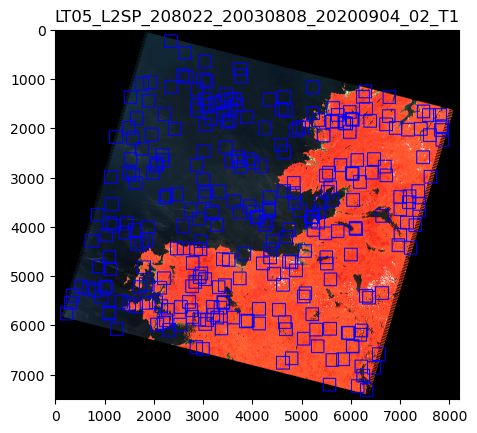

In [124]:
IGB = utils.get_igb(ID)

# draw squares on RGB image using crop locations
for x0,y0 in pos:
    cv2.rectangle(IGB, (y0,x0), (y0+256,x0+256), (0,0,255), 20)

plt.imshow(IGB)
plt.title(ID)

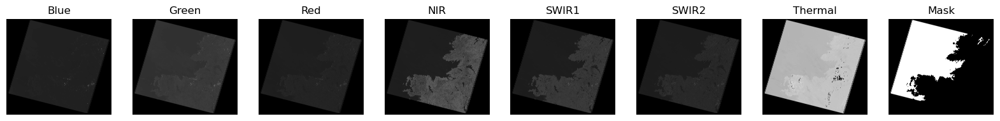

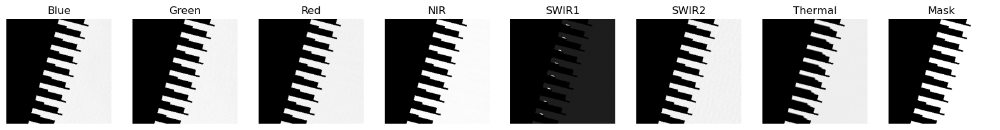

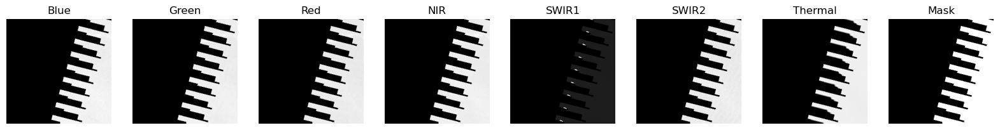

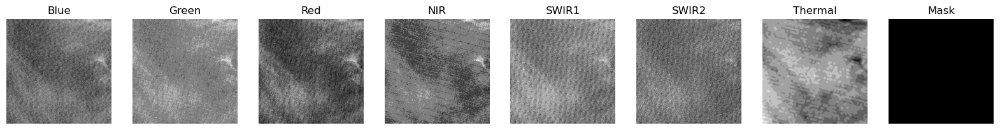

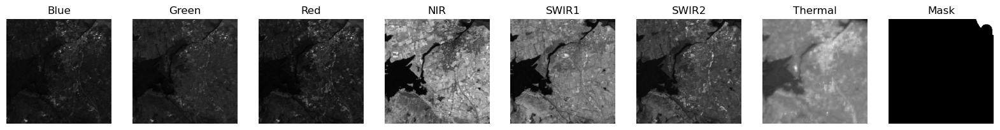

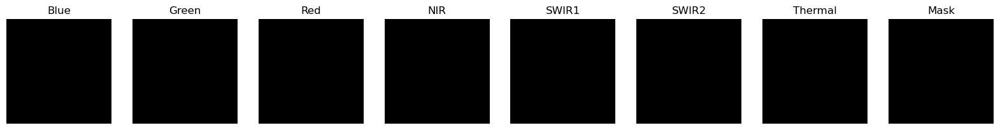

In [127]:
utils.display_bands(bands,True)

# get random crop
crop_bands = random_crop(bands)
utils.display_bands(crop_bands,True)

# get random crop
crop_bands = random_crop(bands)
utils.display_bands(crop_bands,True)

# get random crop
crop_bands = random_crop(bands)
utils.display_bands(crop_bands,True)

# get random crop
crop_bands = random_crop(bands)
utils.display_bands(crop_bands,True)

# get random crop
crop_bands = random_crop(bands)
utils.display_bands(crop_bands,True)

# Archive 

In [111]:
import torch 
import torch.nn as nn
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader

# Variables
train_path = "../data/training/" #UPDATE

class TrainDataset(torch.utils.data.Dataset):
    def __init__(self, paths):
        self.paths = paths


    def __getitem__(self, idx):
        """Get image and binary mask for a given index"""

        path = self.paths[idx]
        instance = np.load(path)

        # Get spectral bands
        bands = instance[:,:,:-1]
        bands = bands[:,:,incl_bands] # Only include specified bands
        bands = bands.astype(np.float32)

        # Normalise bands
        bands = np.clip(bands*0.0000275-0.2, 0, 1)

        # Convert to tensor
        bands = bands.transpose(2,0,1)
        bands = torch.tensor(bands)

        # Get target
        mask_1 = instance[:,:,-1].astype(np.int8) # Water = 1, Land = 0
        mask_0 = 1-mask_1 

        target = np.array([mask_0,mask_1])
        target = torch.Tensor(target).squeeze()
    
        return bands, target

    def __len__(self):
        return len(self.paths)

In [112]:
import glob
paths = glob.glob(train_path + "*")
print("Training images: {}".format(len(paths)))

Training images: 30000


In [118]:
sample = True

if sample: 
    paths = paths[:1000]

# Create a datasets for training and validation
split = int(0.9 * len(paths))
train_data = TrainDataset(paths[:split])
valid_data = TrainDataset(paths[split:])



Bands shape: torch.Size([7, 256, 256])
Min: 0.0 Max: 1.0 Avg: 0.26378417015075684
Target shape: torch.Size([2, 256, 256])
Target unique: tensor([0., 1.])


In [64]:
import os

check_path = "/Users/conorosullivan/Documents/git/COASTAL MONITORING/landsat-coastline-segmentation/data/RGB"

# check if all scenes have been downloaded
for id in df_label['id']:
    path =  id + ".png"
    if path not in os.listdir(check_path):
        print(path)

In [66]:
for i,id in enumerate(df_label['id']):

    path =  "{}.png".format(id)
    im = Image.open("../data/RGB/"+path)
    
    im = np.array(im)
    x, y, z = im.shape
    pixels = x*y

    print(i+1,id, pixels)

1 LC08_L2SP_205023_20170505_20200904_02_T1 65949041
2 LC08_L2SP_205023_20190628_20200827_02_T1 66029851
3 LC08_L2SP_205023_20200529_20200820_02_T1 66111561
4 LC08_L2SP_205024_20150124_20200910_02_T1 66192471
5 LC08_L2SP_205024_20150719_20200909_02_T1 66192471
6 LC08_L2SP_205024_20160331_20200907_02_T1 66192471
7 LC08_L2SP_205024_20190204_20200829_02_T1 66111561
8 LC08_L2SP_205024_20190324_20200829_02_T1 66192471
9 LC08_L2SP_205024_20200411_20200822_02_T1 66192471
10 LC08_L2SP_205024_20210719_20210729_02_T1 66273381
11 LC08_L2SP_205024_20230420_20230429_02_T1 66192471
12 LC08_L2SP_206022_20140418_20200911_02_T1 65942541
13 LC08_L2SP_206022_20140723_20200911_02_T1 65942541
14 LC08_L2SP_206022_20170325_20200904_02_T1 65942541
15 LC08_L2SP_206022_20180702_20200831_02_T1 65942541
16 LC08_L2SP_206022_20230310_20230320_02_T1 65942541
17 LC08_L2SP_206024_20130720_20200912_02_T1 61792821
18 LC08_L2SP_206024_20150421_20200909_02_T1 61792821
19 LC08_L2SP_206024_20170120_20200905_02_T1 61792821
20

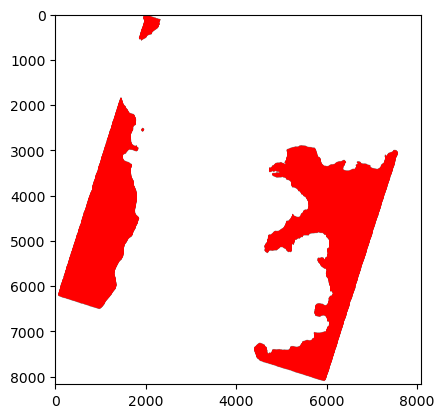

In [29]:
label = Image.open(base_path+"RGB/example - all labels.png")

label = np.array(label)

label.shape

plt.imshow(label)
